https://www.kaggle.com/tarunpaparaju/plant-pathology-2020-eda-models/

# Library Import

In [1]:
import os
import gc
import re

import cv2
import math
import numpy as np
import scipy as sp
import pandas as pd

import tensorflow as tf
from IPython.display import SVG
import efficientnet.tfkeras as efn
from keras.utils import plot_model
import tensorflow.keras.layers as L
from keras.utils import model_to_dot
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.applications import DenseNet121

import seaborn as sns
from tqdm import tqdm
import matplotlib.cm as cm
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

tqdm.pandas()
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

np.random.seed(0)
tf.random.set_seed(0)

import warnings
warnings.filterwarnings("ignore")

Using TensorFlow backend.


# Load Data

In [2]:
EPOCHS = 20
SAMPLE_LEN = 100
IMAGE_PATH = '/data/backup/pervinco_2020/datasets/plant-pathology-2020-fgvc7/images/'
TEST_PATH = '/data/backup/pervinco_2020/datasets/plant-pathology-2020-fgvc7/test.csv'
TRAIN_PATH = '/data/backup/pervinco_2020/datasets/plant-pathology-2020-fgvc7/train.csv'
SUB_PATH = '/data/backup/pervinco_2020/datasets/plant-pathology-2020-fgvc7/sample_submission.csv'

sub = pd.read_csv(SUB_PATH)
test_data = pd.read_csv(TEST_PATH)
train_data = pd.read_csv(TRAIN_PATH)

In [3]:
train_data.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


In [4]:
test_data.head()

,image_id
0,Test_0
1,Test_1
2,Test_2
3,Test_3
4,Test_4


In [5]:
def load_image(image_id):
    file_path = image_id + ".jpg"
    image = cv2.imread(IMAGE_PATH + file_path)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

train_images = train_data["image_id"][:SAMPLE_LEN].progress_apply(load_image)

100%|██████████| 100/100 [00:02<00:00, 47.38it/s]


In [6]:
fig = px.imshow(cv2.resize(train_images[0], (205, 136)))
fig.show()

위의 훈련 데이터에서 첫번째 이미지를 ploting했습니다. RGB값은 이미지 위로 마우스를 가져가 볼 수 있습니다.  
이미지의 녹색 부분은 파란색 값이 매우 낮으나, 대조적으로 갈색 부분은 파란색 값이 높습니다.  
이는 이미지의 녹색(건강한)부분이 파란색 값이 낮고 건강하지 않은 부분은 높은 파란색 값을 가질 가능성이 높다는 것을 나타냅니다.  
이것은 파란색 채널이 식물의 질병을 감지하는 열쇠가 될 수 있음을 시사하는 부분입니다.

# Channel Distributions

In [7]:
red_values = [np.mean(train_images[idx][:, :, 0]) for idx in range(len(train_images))]
green_values = [np.mean(train_images[idx][:, :, 1]) for idx in range(len(train_images))]
blue_values = [np.mean(train_images[idx][:, :, 2]) for idx in range(len(train_images))]
values = [np.mean(train_images[idx]) for idx in range(len(train_images))]

## ALL Channel values

In [8]:
fig = ff.create_distplot([values], group_labels=["Channels"], colors=["purple"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of channel values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

채널 값은 105정도를 중심으로 대략 정규 분포를 갖는 것으로 보입니다.  
최대 채널 활성 값은 255입니다.(픽셀이 가질수 있는 최대값이 255니까.) 이는 평균 채널 값이 최대 값의 절반보다 작음(125보다 작음)을 의미하고 대부분의 시간에 채널이 최소로 활성화됨을 나타냅니다. 


## Red Channel values

In [9]:
fig = ff.create_distplot([red_values], group_labels=["R"], colors=["red"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of red channel values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

Red channel 값은 대략 정규 분포인 것처럼 보이지만 약간 오른쪽으로 비뚤어져있습니다.(positive skew)  
이것은 Red 채널이 약 100에서 더 낮은 값으로 집중되는 경향이 있음을 나타냅니다. 이미지 전체의 평균 빨간색 값에는 큰 차이가 있습니다.

## Green Channel values

In [10]:
fig = ff.create_distplot([green_values], group_labels=["G"], colors=["green"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of green channel values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

Green Channel은 Red Channel 값보다 더 균일한 분포를 가지며 피크가 더 작습니다.  
분포는 왼쪽으로 치우치며, 약 140보다 더 큰 형태입니다. 이것은 녹색보다 이미지에서 녹색이 더 두드러짐을 나타냅니다. 이것은 잎의 이미지이기 때문에 의미가 있습니다.

## Blue Channel vlaues

In [11]:
fig = ff.create_distplot([blue_values], group_labels=["B"], colors=["blue"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of blue channel values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

Blue Channel은 3개의 색상 채널 중에서 가장 균일한 분포를 가지고 있으며,  
약간의 비대칭(약간의 왼쪽 비뚤어짐)이 있습니다. 파란색 채널은 데이터 셋의 이미지에서 큰 변화를 보여줍니다.

In [12]:
fig = go.Figure()

for idx, values in enumerate([red_values, green_values, blue_values]):
    if idx == 0:
        color = "Red"
    if idx == 1:
        color = "Green"
    if idx == 2:
        color = "Blue"
    fig.add_trace(go.Box(x=[color]*len(values), y=values, name=color, marker=dict(color=color.lower())))
    
fig.update_layout(yaxis_title="Mean value", xaxis_title="Color channel",
                  title="Mean value vs. Color channel", template="plotly_white")

In [13]:
fig = ff.create_distplot([red_values, green_values, blue_values],
                         group_labels=["R", "G", "B"],
                         colors=["red", "green", "blue"])
fig.update_layout(title_text="Distribution of red channel values", template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig.data[2].marker.line.color = 'rgb(0, 0, 0)'
fig.data[2].marker.line.width = 0.5
fig

위 그림에서 잎 이미지에 대해 어떤 색이 더 흔하고 어떤 색이 더 흔하지 않은지 명확하게 알 수 있습니다.  
녹색, 빨간색, 파란색 순으로 가장 뚜렷한 색상이며, 분포를 함께 plot하면 모양이 비슷해 보이지만 수평으로 이동합니다.

# Visuallize Sample leaves

In [14]:
def visualize_leaves(cond=[0, 0, 0, 0], cond_cols=["healthy"], is_cond=True):
    if not is_cond:
        cols, rows = 3, min([3, len(train_images)//3])
        fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
        for col in range(cols):
            for row in range(rows):
                ax[row, col].imshow(train_images.loc[train_images.index[-row*3-col-1]])
        return None
        
    cond_0 = "healthy == {}".format(cond[0])
    cond_1 = "scab == {}".format(cond[1])
    cond_2 = "rust == {}".format(cond[2])
    cond_3 = "multiple_diseases == {}".format(cond[3])
    
    cond_list = []
    for col in cond_cols:
        if col == "healthy":
            cond_list.append(cond_0)
        if col == "scab":
            cond_list.append(cond_1)
        if col == "rust":
            cond_list.append(cond_2)
        if col == "multiple_diseases":
            cond_list.append(cond_3)
    
    data = train_data.loc[:100]
    for cond in cond_list:
        data = data.query(cond)
        
    images = train_images.loc[list(data.index)]
    cols, rows = 3, min([3, len(images)//3])
    
    fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
    for col in range(cols):
        for row in range(rows):
            ax[row, col].imshow(images.loc[images.index[row*3+col]])
    plt.show()

## Healthy leaves

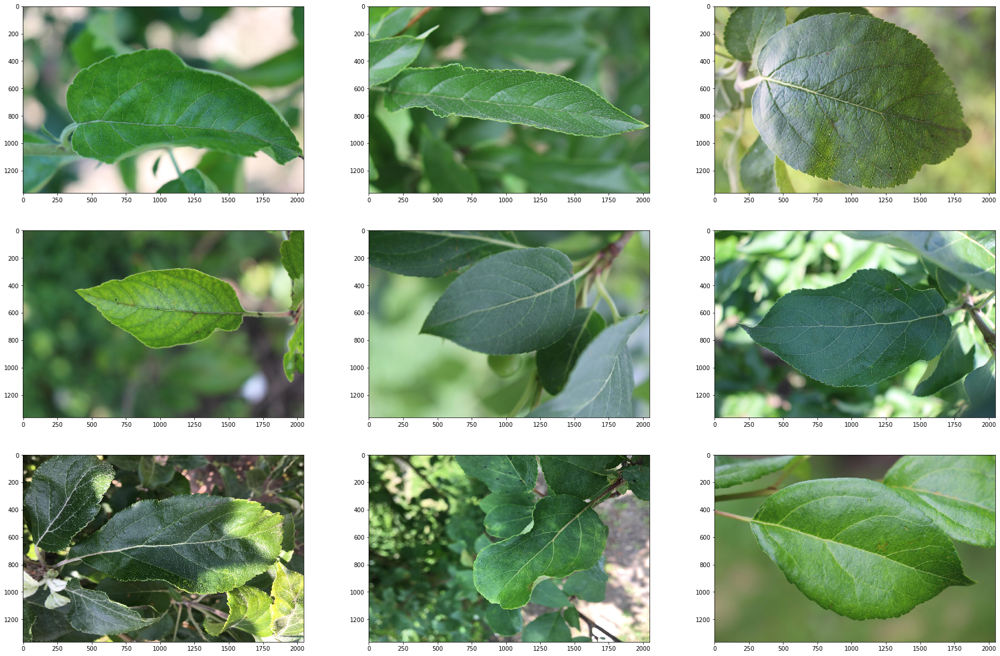

In [15]:
visualize_leaves(cond=[1, 0, 0, 0], cond_cols=["healthy"])


위의 이미지에서 건강한 잎이 완전히 녹색이며, 갈색/노란색 반점이나 흉터가 없음을 알 수 있습니다.  
건강한 잎에는 반점이나 흉터가 없습니다.

## Leaves with scab

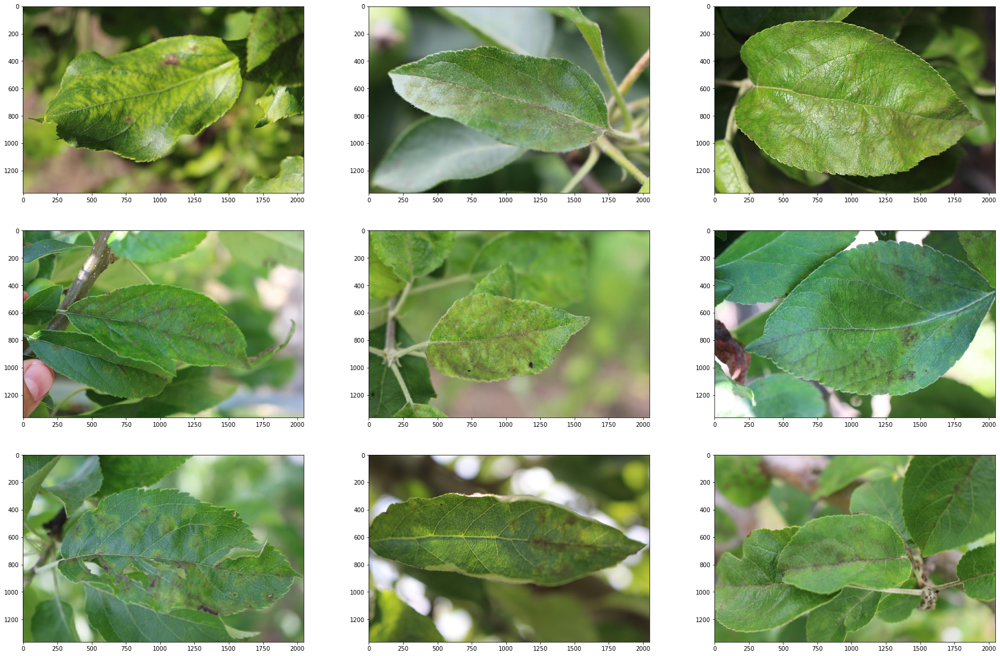

In [16]:
visualize_leaves(cond=[0, 1, 0, 0], cond_cols=["scab"])

위의 이미지에서 딱지가 있는 잎은 잎에 큰 갈색 자국과 얼룩이 있음을 알 수 있습니다.  
딱지는 곰팡이 또는 박테리아에 의해 발생하여 과일, 잎 또는 뿌리에 딱딱한 반점이 발생하는 다양한 식물 질병 중 하나로 정의됩니다.  
잎을 가로지르는 갈색 자국은 이러한 박테리아/곰팡이 감염의 징후입니다. 딱지는 화학적 또는 화학적이 아닌 방법으로 치료가 가능합니다.

## Leaves with rust

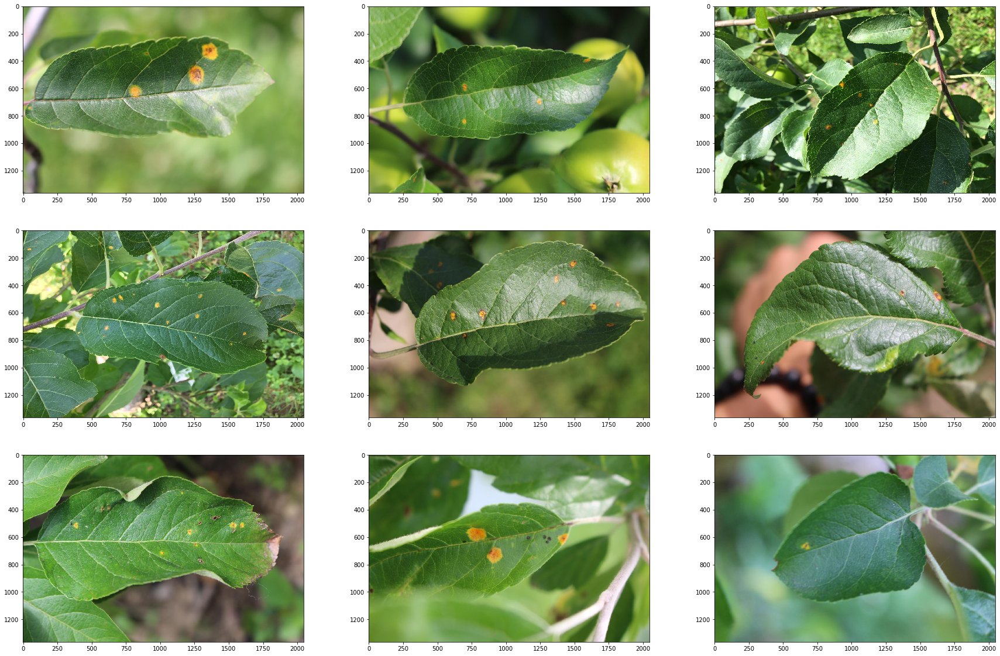

In [17]:
visualize_leaves(cond=[0, 0, 1, 0], cond_cols=["rust"])


위 이미지에서 녹이 있는 잎은 잎에 여러 갈색-노란색 반점이 있음을 알 수 있습니다.  
녹은 병에 걸린 잎과 잎날에 녹색의 포자(농포)가 특징이며 여러 녹 곰팡이에 의해 유발되는 질병으로 특히 곡물 및 기타 잔디 질병으로 정의됩니다.  
노란색 반점은 녹 곰팡이라고 하는 특수한 곰팡이 유형에 의한 감염의 징후입니다. 녹은 일단 진단되면 여러가지 화학적, 비화학적 방법으로 치료할 수 있습니다.

## Leaves with multiple diseases

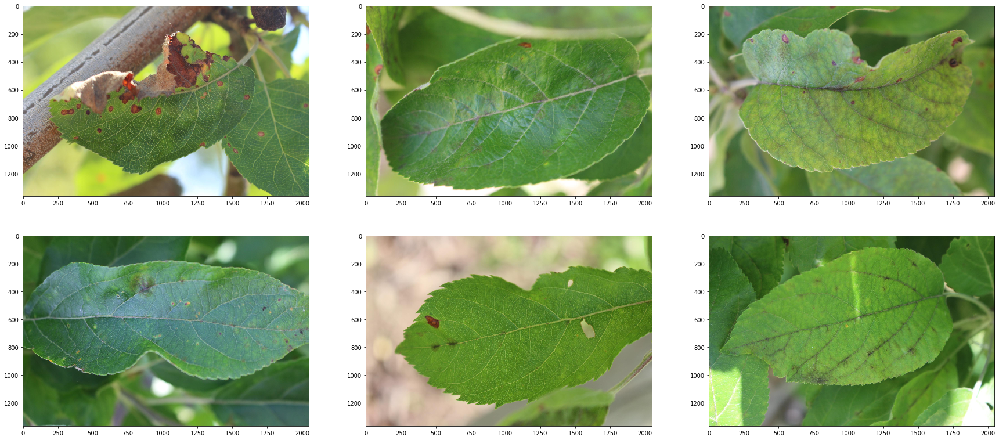

In [18]:
visualize_leaves(cond=[0, 0, 0, 1], cond_cols=["multiple_diseases"])

위 이미지에서 잎은 갈색 자국과 노란색 반점을 포함한 여러 질병의 증상을 나타냅니다. 이 식물들은 상기 질병 중 하나 이상을 가지고 있습니다.

이제 레이블과 대상 데이터를 시각화 하겠습니다. 아래의 모든 그림에서 파란색은 건강한 상태를 나타내고 빨간색은 건강하지 않은 상태를 나타냅니다.


## All labels together (parallel plot)

In [19]:
fig = px.parallel_categories(train_data[["healthy", "scab", "rust", "multiple_diseases"]], color="healthy", color_continuous_scale="sunset",\
                             title="Parallel categories plot of targets")
fig

위 그림에서 네 가지 범주 모두의 관계를 볼 수 있습니다.  
예상대로 건강한 잎(healthy == 1)은 딱지, 녹 또는 여러 질병을 앓을 수 없습니다.

## Pie chart

In [20]:
fig = go.Figure([go.Pie(labels=train_data.columns[1:],
           values=train_data.iloc[:, 1:].sum().values)])
fig.update_layout(title_text="Pie chart of targets", template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.show()

위 원형 차트에서 데이터셋의 대부분, 71.7%의 잎이 건강한 잎이 아닌 것을 알 수 있습니다.  
식물의 5%만이 multiple_diseases에 해당되며 녹과 딱지는 각각 pie의 1/3을 차지합니다.

## Healthy distribution

In [21]:
train_data["Healthy"] = train_data["healthy"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Healthy", title="Healthy distribution", color="Healthy",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[0],
                "False": px.colors.qualitative.Plotly[1]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

건강한 잎(healthy == 1)과 건강하지 못한 잎(healthy == 0)으로 분포를 확인해 보았을 때,  
건강하지 못한 식물이 더 많은 것을 볼 수 있습니다. 건강한 잎은 516으로 28%, 건강하지 못한 잎은 1305로 72%를 차지하고 있습니다.

## scab distribution

In [22]:
train_data["Scab"] = train_data["scab"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Scab", color="Scab", title="Scab distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[0]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

딱지가 없는 잎(scab==1) 보다 딱지가 없는 잎(scab==0)이 더 많다는 것을 알 수 있습니다.  
건강하지 못한 잎 592(33%)와 건강한 잎 1229(67%)가 있습니다.

## Rust distribution

In [23]:
train_data["Rust"] = train_data["rust"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Rust", color="Rust", title="Rust distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[0]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

녹이 있는 식물(rust==1)보다 녹이 없는 식물(rust==0)이 더 많다는 것을 알 수 있습니다.  
건강하지 못한 식물은 662(34%), 건강한 식물은 1199(66%)입니다.   
건강하지 못한 식물의 비율이 녹과 딱지에 대해 매우 유사함을 확인할 수 있습니다.

## Multiple diseases distribution

In [24]:
train_data["Multiple diseases"] = train_data["multiple_diseases"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Multiple diseases", color="Multiple diseases", title="Multiple diseases distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[0]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

multiple diseases를 가지고 있는 잎들은 매우 극소수이며, 건강한 잎은 95%(1730)이고, 건강하지 못한 식물은 5%(91)입니다.

# Image processing and augmentation

## Canny edge detection
Canny는 매우 인기 있는 edge detection 알고리즘으로, 이름에서 알 수 있듯이 이미지에 있는 물체의 가장자리를 감지합니다.  
이 알고리즘은 다음 몇단계를 포함합니다.

1. Noise reduction  
    노이즈 감소. edge detection은 이미지의 noise에 민감하기 때문에 5*5 Gaussian filter를 적용해 이미지의 noise를 제거합니다.

2. Finding Intensity Gradient of the Image  
    이미지의 Intensity Gradient를 찾는다. 노이즈를 제거한 다음 이미지를 가로 및 세로 방향으로 Sobel Kernel로 필터링하여 가로 G<sub>x</sub>와 세로 G<sub>y</sub>방향의 첫번째 미분을 구합니다. 
    이 두 이미지에서(가로, 세로에 sobel mask를 적용해 얻은 2개의 이미지 인듯?) 각각 가장자리 경사와 각 픽셀의 방향을 찾을 수 있습니다.  
    ![img1](doc_imgs/Intensity_gradient0.png)  
    ![img2](doc_imgs/Intensity_gradient.png)  
    
3. Rounding  
    경사는 항상 가장자리에 수직입니다. 따라서 세로, 가로 및 두 개의 대각선 방향을 나타내는 네 가지 각도 중 하나로 반올림됩니다.  

4. Non-maximum suppression
    경사 크기와 방향을 얻은 후에는 이미지를 전체 스캔하여 가장자리를 구성하지 않는 불필요한 픽셀을 제거합니다.  
    이를 위해 경사 방향의 모든 픽셀이 주변 지역에 최대 값인지 확인해야합니다.

5. Hysteresis Thresholding  
    이 단계에서는 어느 부분이 가장자리인지 아닌지를 결정합니다. 이를 위해 min_val과 max_val의 두가지 임계값이 필요합니다.  
    max_val보다 큰 강도 기울기를 가진 가장자리는 edge로 간주되고 min_val보다 작은 가장자리는 가장자리가 아닌 것으로 간주되어 버려집니다.  
    이 두 임계 값 사이에 있는 값들은 주변 지역을 기준으로 edge 또는 non-edge로 분류됩니다. edge픽셀에 가까우면 가장자리로 간주되고 그렇지 않으면 버려집니다.

이 다섯 단계의 결과는 이미지의 가장자리 위치를 나타내는 2차원 이진 비트맵(0 또는 255)입니다.

In [25]:
def edge_and_cut(img):
    emb_img = img.copy()
    edges = cv2.Canny(img, 100, 200)
    edge_coors = []
    for i in range(edges.shape[0]):
        for j in range(edges.shape[1]):
            if edges[i][j] != 0:
                edge_coors.append((i, j))
    
    row_min = edge_coors[np.argsort([coor[0] for coor in edge_coors])[0]][0]
    row_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][0]
    col_min = edge_coors[np.argsort([coor[1] for coor in edge_coors])[0]][1]
    col_max = edge_coors[np.argsort([coor[1] for coor in edge_coors])[-1]][1]
    new_img = img[row_min:row_max, col_min:col_max]
    
    emb_img[row_min-10:row_min+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_max-10:row_max+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_min:row_max, col_min-10:col_min+10] = [255, 0, 0]
    emb_img[row_min:row_max, col_max-10:col_max+10] = [255, 0, 0]
    
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img, cmap='gray')
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(edges, cmap='gray')
    ax[1].set_title('Canny Edges', fontsize=24)
    ax[2].imshow(emb_img, cmap='gray')
    ax[2].set_title('Bounding Box', fontsize=24)
    plt.show()

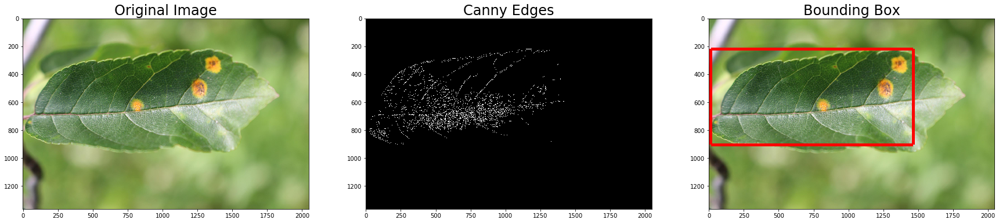

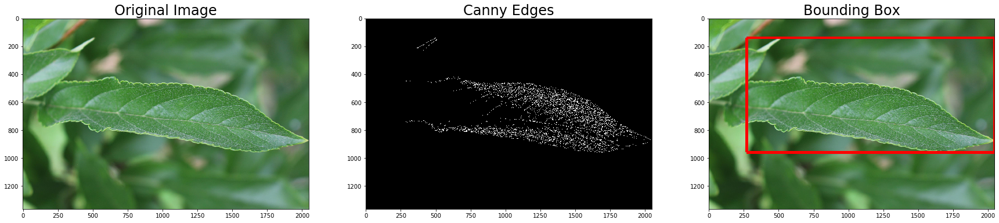

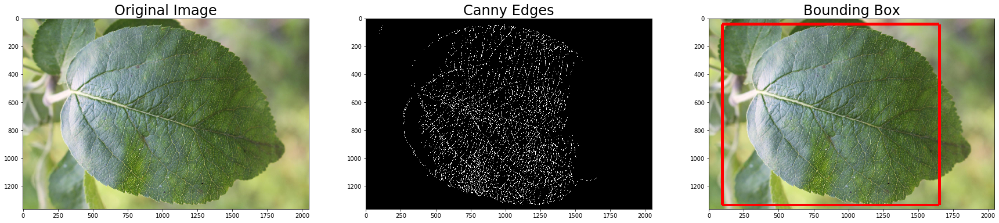

In [26]:
edge_and_cut(train_images[3])
edge_and_cut(train_images[4])
edge_and_cut(train_images[5])

위 이미지의 두번째 열에는 canny edge가 있고 세번째 열에는 잘린 이미지가 있습니다.  
canny edge를 가져와서 실제 잎이 포함된 bounding box를 예측하는데 사용했습니다. 이미지의 네 모서리에서 가장 extrme한 가장자리는 bounding box의 꼭지점입니다.  
이 빨간색 상자에는 잎의 전체가 들어있지 않은 경우가 대부분일 수 있습니다. 이 모서리와 bounding box를 사용하여 보다 정확한 모델을 만들 수 있습니다.

## Flipping
Flipping은 이미지 채널에서 인덱스 전환을 포함하는 간단한 변환입니다.  
수직 flip에서는 행 순서가 교환되는 변면 수평 filp에서는 열 순서가 교환됩니다.  
A<sub>ijk</sub>가 flip을 적용할 이미지라고 가정해보자. 수평 및 수직 flip은 아래 공식으로 나타낼 수 있습니다.  
![img](doc_imgs/flip1.png)  
![img](doc_imgs/flip2.png)  
![img](doc_imgs/flip3.png)  

열 순서가 horizontal flip방식으로 바뀌는 것을 볼 수 있습니다. i와 k 인덱스는 동일하게 유지되지만 j 인덱스는 반대로 됩니다.  
반면 vertical flip방식에서는 행 순서가 horizontal flip방식으로 바뀝니다. j와 k 인덱스는 동일하게 유지되지만 i 인덱스는 반대로 됩니다.

In [27]:
def invert(img):
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.flip(img, 0))
    ax[1].set_title('Vertical Flip', fontsize=24)
    ax[2].imshow(cv2.flip(img, 1))
    ax[2].set_title('Horizontal Flip', fontsize=24)
    plt.show()

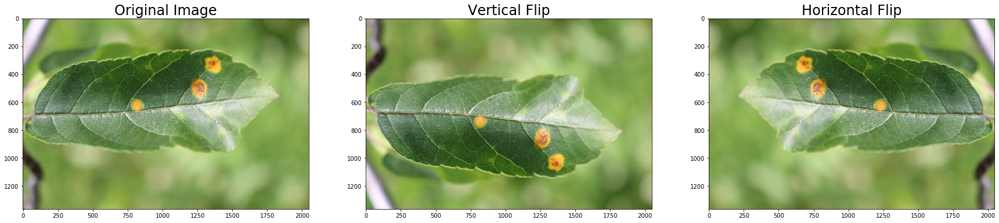

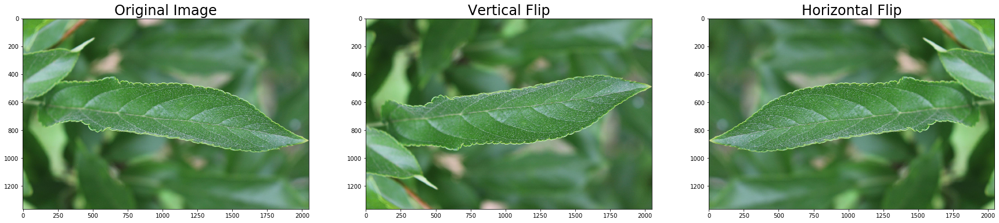

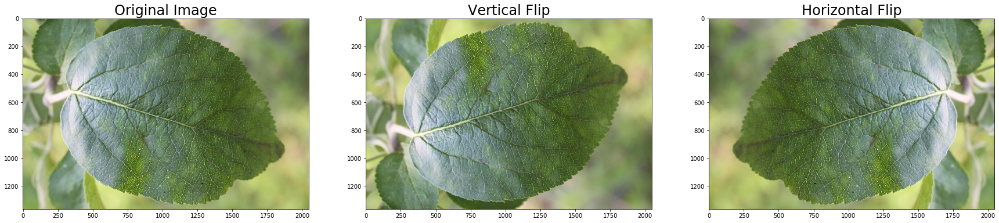

In [28]:
invert(train_images[3])
invert(train_images[4])
invert(train_images[5])

이미지가 단순히 뒤집힌 것을 볼 수 있습니다. 이미지의 모든 주요 기능은 동일하게 유지되지만 컴퓨터 알고리즘에 따라 뒤집힌 이미지는 완전히 다르게 보입니다.  
이러한 변환은 데이터 기능 보강에 사용되어 모델을 보다 강력하고 정확하게 만들 수 있습니다.

## Convolution

컨볼루션은 전체 이미지 위로 이동하는 Kernel(2d metrix)을 포함하는 다소 간단한 알고리즘입니다.  
![](doc_imgs/convolution.gif)  

위의 과정은 방정식으로 요약할 수 있습니다. 여기서 f는 이미지, h는 커널입니다. f의 차원은 (m, n)이고 커널은 f보다 작은 차원을 가진 정사각 행렬입니다.
![](doc_imgs/convolution.png)  
위의 방정식에서 커널 h는 이미지의 길이와 너비를 가로질러 움직입니다.  
서브 매트릭스 또는 매트릭스 f의 윈도우를 갖는 h의 내적은 각 단계에서 취해지는 이중합산(행,열)이다. 아래에서는 잎 이미지에 대한 컨볼루션 효과를 보여준다.

In [29]:
def conv(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    kernel = np.ones((7, 7), np.float32)/25
    conv = cv2.filter2D(img, -1, kernel)
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(conv)
    ax[1].set_title('Convolved Image', fontsize=24)
    plt.show()

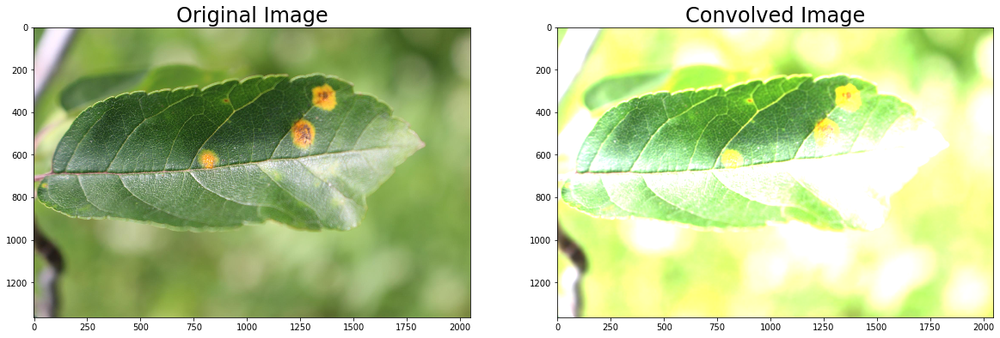

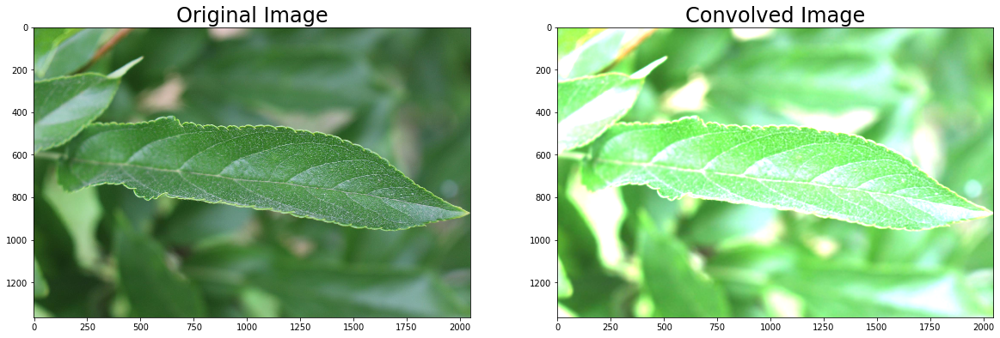

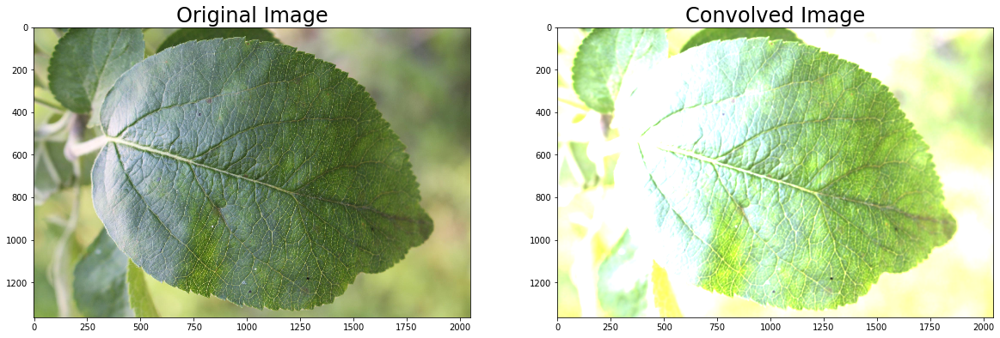

In [30]:
conv(train_images[3])
conv(train_images[4])
conv(train_images[5])

컨볼루션 연산자는 이미지에 sunshine 효과를 더하는 것 같습니다. 이는 또한 데이터를 보강하는 목적으로 사용될 수 있으므로 강력하고 정확한 모델을 구축하는데 도움이 됩니다.

## Blurring

blurring은 단순히 이미지에 노이즈를 추가하여 이미지의 선명도가 떨어집니다. 이를 적용함으로 인해 사소한 세부사항들이 난독 처리 됩니다.  
Blur변환은 아래 방정식을 사용하여 표현할 수 있습니다.  
![](doc_imgs/blur.png)  

이번 예제에서는 평균이 0, 분산이 0.1인 Gaussian 분포를 사용합니다.

In [31]:
def blur(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.blur(img, (100, 100)))
    ax[1].set_title('Blurred Image', fontsize=24)
    plt.show()

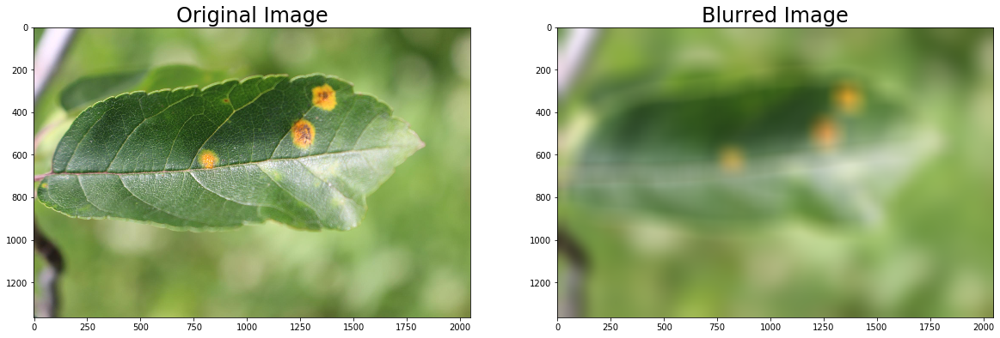

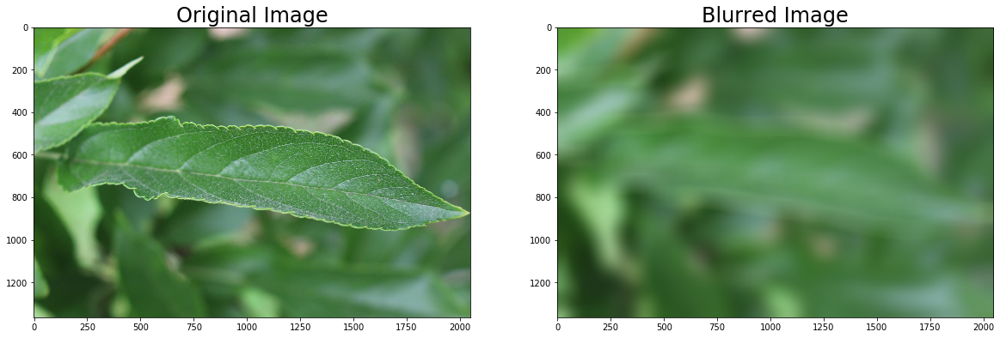

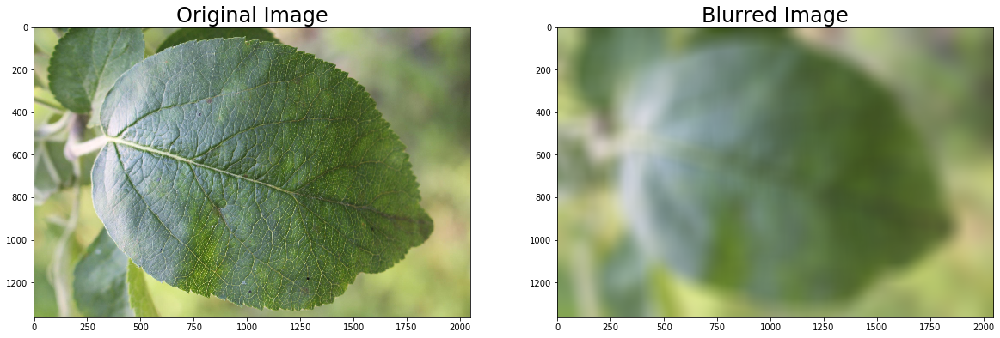

In [32]:
blur(train_images[3])
blur(train_images[4])
blur(train_images[5])

# Modeling

모델을 작성하기 전에 미리 훈련된 CV모델의 주요 구성요소를 설명하겠습니다.  
모든 주요 ImageNet모델에는 서로 다른 아키텍쳐가 있지만 각 모델에는 공통적인 블록: Conv2D. MaxPool, ReLU가 있습니다.  
컨볼루션은 앞서 설명했으니, MaxPool과 ReLU에 관해 설명하겠습니다.

## MaxPool
maxpooling은 커널을 사용하여 창의 내적을 찾는 대신 창에서 최대 값을 찾는 것으로 컨볼루션과 매우 유사합니다.  
maxpool에서는 커널이 필요하지 않으며, CNN 컨볼루션 피쳐 맵의 차원을 줄이는데 매우 유용합니다.  
![](doc_imgs/maxpool.png)  
![](doc_imgs/maxpool2.png)
위 방정식에서 창은 이미지를 가로질러 이동하며, 각 창의 최대 값이 계산됩니다.

## ReLU
relu는 신경망 아키텍처에서 일반적으로 사용되는 활성화 기능입니다. Activation Function.  
ReLU(x)에서 x가 0 보다 작을경우, 0을 반환하고, 0보다 클 경우 x를 반환합니다.  
이 기능은 신경망에 비선형성을 도입하여 이미지 데이터를 모델링하는 용량을 증가시킵니다.  
![](doc_imgs/relu1.png)  
![](doc_imgs/relu2.png)  
앞에서 언급했듯 기능은 비선형이며, CNN모델의 용량을 늘리는데 도움이 됩니다.